In [68]:
# -*- coding: utf-8 -*-
#  Copyright 2023 United Kingdom Research and Innovation
#
#  Licensed under the Apache License, Version 2.0 (the "License");
#  you may not use this file except in compliance with the License.
#  You may obtain a copy of the License at
#
#      http://www.apache.org/licenses/LICENSE-2.0
#
#  Unless required by applicable law or agreed to in writing, software
#  distributed under the License is distributed on an "AS IS" BASIS,
#  WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
#  See the License for the specific language governing permissions and
#  limitations under the License.
#
#   Authored by:  Margaret Duff (UKRI-STFC), Edooardo Pasca (UKRI-STFC),  Tommi Heikkilä (University of Helsinki, Finland)

# Low Dose Fan Beam medical CT reconstruction using wavelets 

This showcase was inspired by the work of the CIL team alongside Tommi Heikkilä for the [ICASSP-2024 3D-CBCT challenge ](https://sites.google.com/view/icassp2024-spgc-3dcbct/home). Although we did not submit an entry, as the challenge was aimed at deep learning based methods, the work and this notebook demonstrates some useful development of wavelet regularisation on a medical CT dataset.

In [69]:

import numpy as np
from cil.framework import ImageGeometry, AcquisitionGeometry, DataOrder
from cil.utilities.display import show2D, show_geometry, show1D
from cil.framework import AcquisitionData
from cil.recon import FDK
from cil.optimisation.functions import  L2NormSquared,  MixedL21Norm, L1Norm, LeastSquares, TotalVariation
from cil.plugins.astra import ProjectionOperator
from cil.optimisation.algorithms import PDHG, FISTA
from cil.optimisation.functions import BlockFunction, IndicatorBox
from cil.optimisation.operators import BlockOperator, GradientOperator
from cil.utilities.quality_measures import mse
from cil.framework import ImageData

import matplotlib.pyplot as plt

from CIL_Wavelets import WaveletOperator
import h5py

# set up default colour map for visualisation
cmap = "gray"

# set the backend for FBP and the ProjectionOperator
device = 'gpu'

In [70]:
### CIL Version 23.0.1

In [71]:
import cil
print(cil.__version__)

23.1.0


In [72]:
### Dataset

We use data from the [LoDoPabB-CT dataset](https://www.nature.com/articles/s41597-021-00893-z). We extract just one slice from the test ground truth images which can be downloaded from zenodo: https://zenodo.org/records/3384092/files/ground_truth_test.zip

(128, 362, 362)


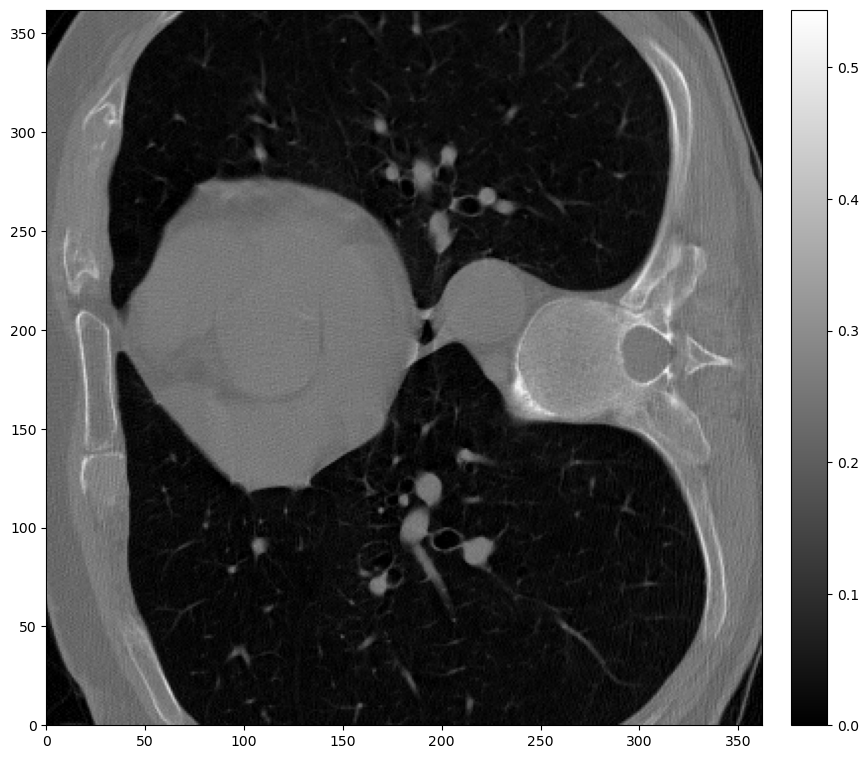

In [73]:

filename = f'ground_truth_test_000.hdf5'

ground_truth=np.array(h5py.File(filename,'r')['data'])
print(ground_truth.shape)
show2D(ground_truth[63])

We take just one slice, as this is not a 3D dataset and the patient data is mixed up, and reorientate the image so that spine is at the bottom of the image. 

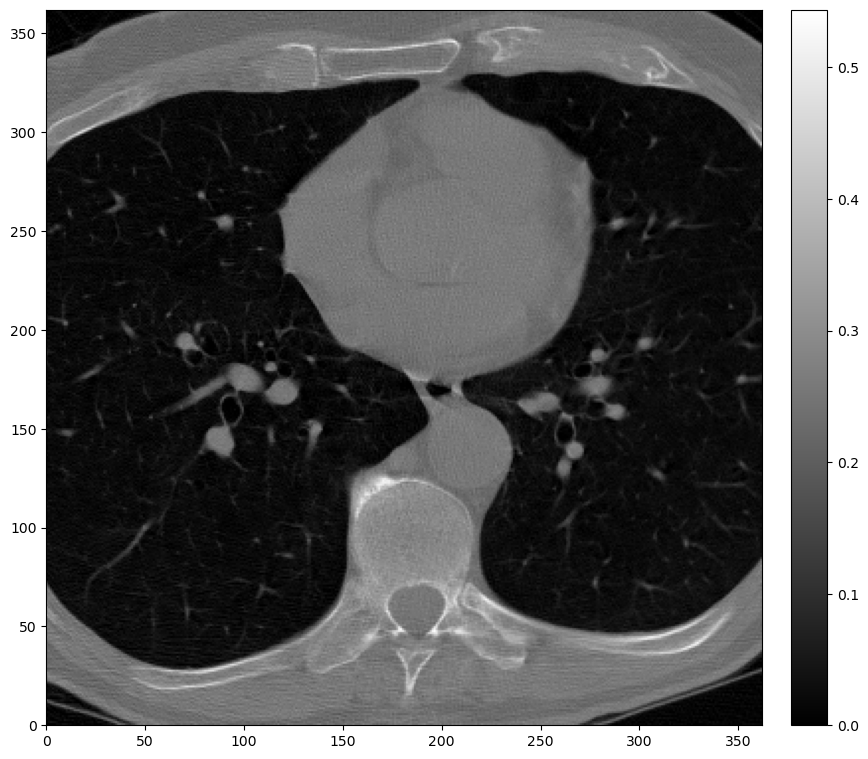

In [74]:
ground_truth_slice=np.fliplr(ground_truth[63]).transpose()
show2D(ground_truth_slice)

### Set up the geometry needed for the data

We choose a feasible geometry set-up for the data, choosing a fan-beam geometry for this individual slice. 

In [75]:
image_size = [300, 300]
image_shape = [362, 362]
voxel_size = [1.171875, 1.171875]

detector_shape = [512, 1]
detector_size = [600, 1]
pixel_size = [2.34375, 2.34375]

distance_source_origin = 1150
distance_source_detector = 2010



angles = np.linspace(0, 2*np.pi, 360, endpoint=False)

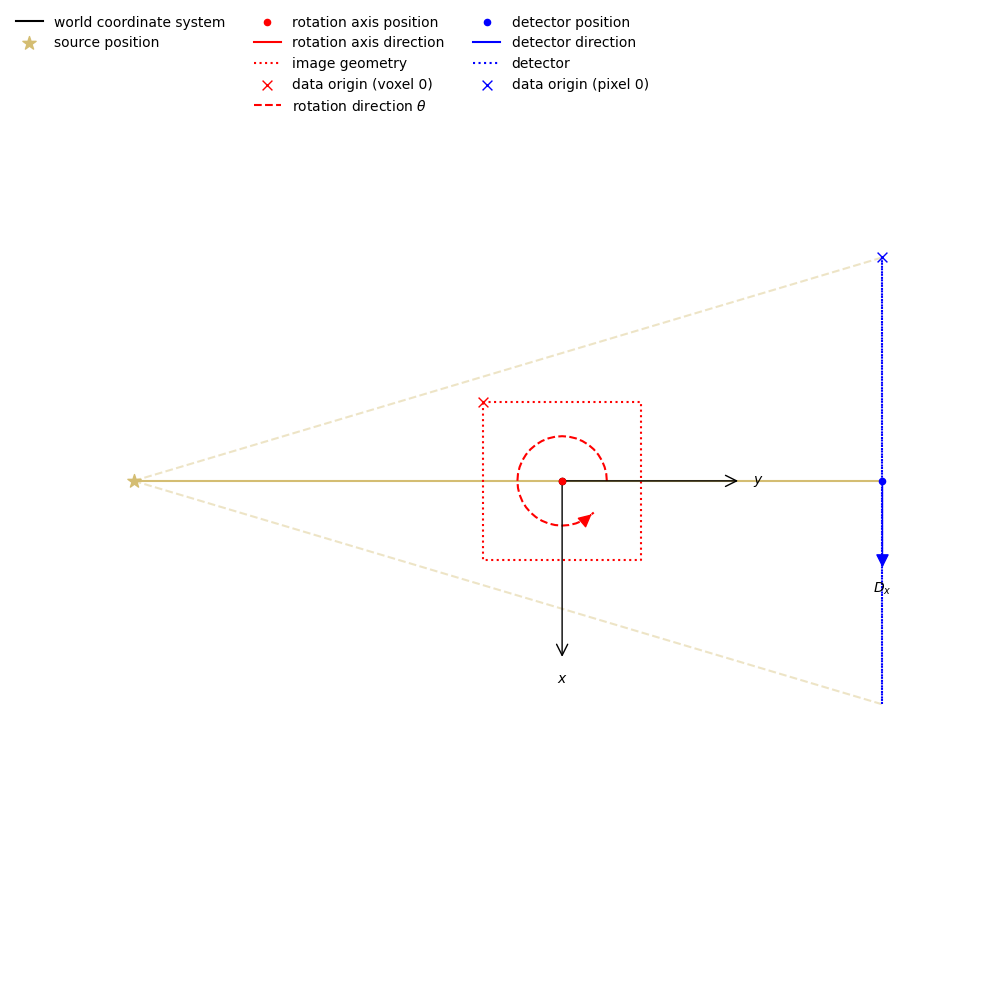

In [76]:
AG = AcquisitionGeometry.create_Cone2D(source_position=[0, -distance_source_origin],\
                                       detector_position=[0, distance_source_detector-distance_source_origin],)\
                                        .set_angles(-angles, angle_unit='radian')\
                                        .set_panel(detector_shape, pixel_size, origin='bottom-left')\
                                        .set_labels(DataOrder.ASTRA_AG_LABELS[:])
ig = ImageGeometry(voxel_num_x=image_shape[0], voxel_num_y=image_shape[1],\
                     voxel_size_x=voxel_size[0], voxel_size_y=voxel_size[1])

show_geometry(AG, ig)


### Simulate data 

We simulate low dose data by first creating a clean sinogram

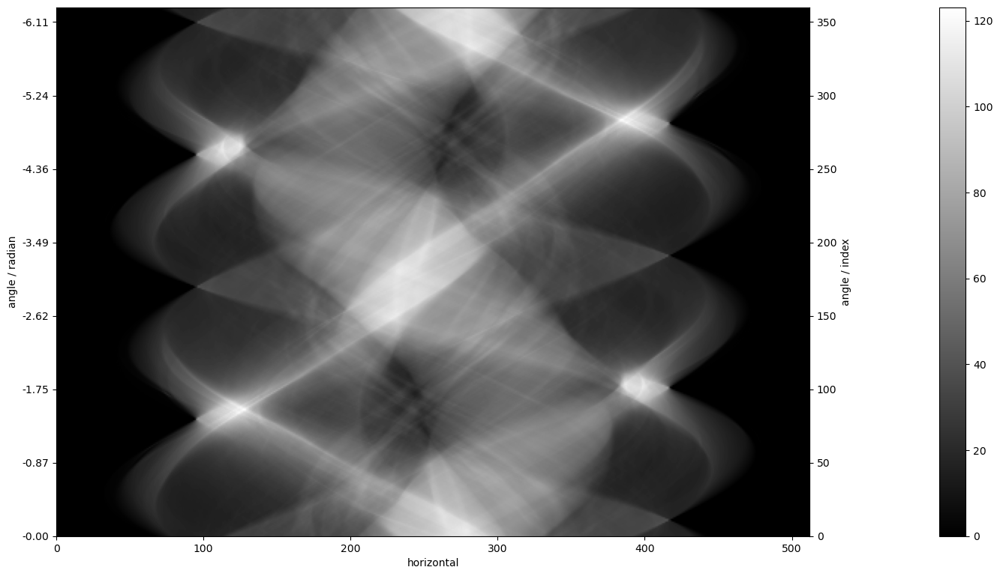

In [77]:
A = ProjectionOperator(ig, AG)
gt=ImageData(ground_truth_slice, geometry=ig)
sinogram=A.direct(gt)
show2D(sinogram)





We then add possion noise to the transmission data becfore converting back to the absorption space. Note that the normalisation by `sinogram.max()` before taking the exponential and then scaling again after the log is to prevent numerical errors when taking the exponential of large negative numbers. 

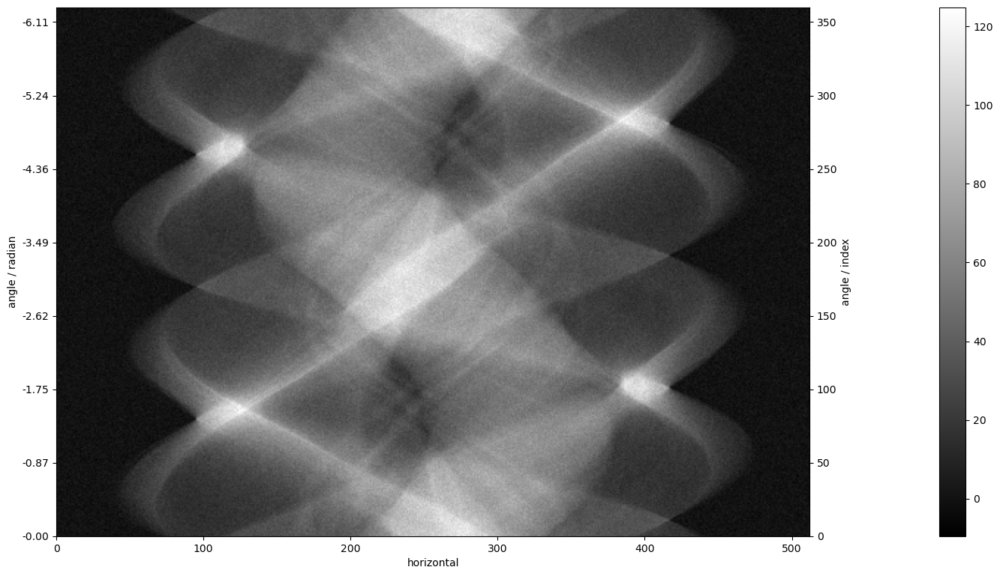

In [78]:

background_counts = 2500


counts = background_counts * np.exp(-sinogram.as_array()/sinogram.max())
noisy_counts = np.random.poisson(counts)
sino_out = -np.log(noisy_counts/background_counts)*sinogram.max()

sinogram_noisy = AG.allocate()
sinogram_noisy.fill(sino_out)
show2D(sinogram_noisy)

An FDK reconstruction shows the effect of the added noise

FDK recon

Input Data:
	angle: 360
	horizontal: 512

Reconstruction Volume:
	horizontal_y: 362
	horizontal_x: 362

Reconstruction Options:
	Backend: tigre
	Filter: ram-lak
	Filter cut-off frequency: 1.0
	FFT order: 10
	Filter_inplace: False



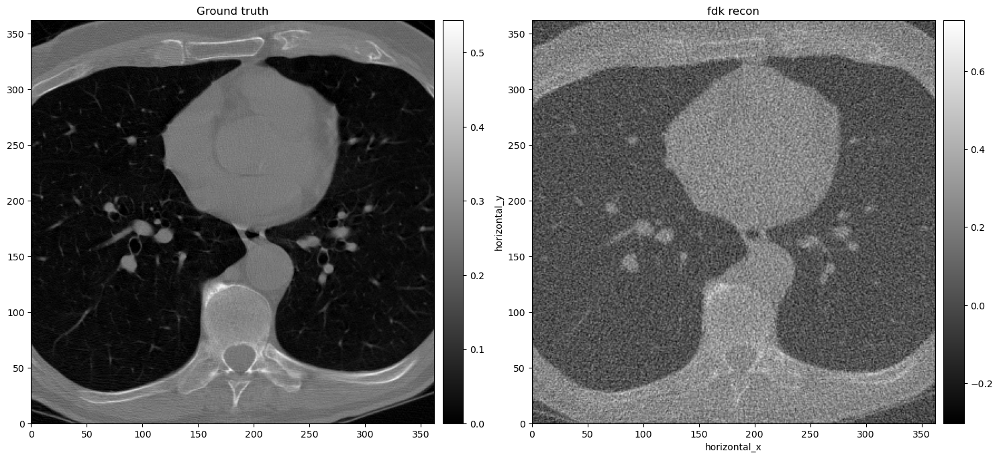

In [79]:
fdk = FDK(sinogram_noisy, ig).run()

show2D([ground_truth_slice, fdk], title=['Ground truth', 'fdk recon'])

### TV regularisation

We first try TV regularisation with FISTA. E bound the reconstrcted ctimage from below by 0 and from above by the maximum value of the FDK reconstruction. We try a range of regularisation parameters to find optimum values for this data.  MATHS HERE.

0.00046197132569253635


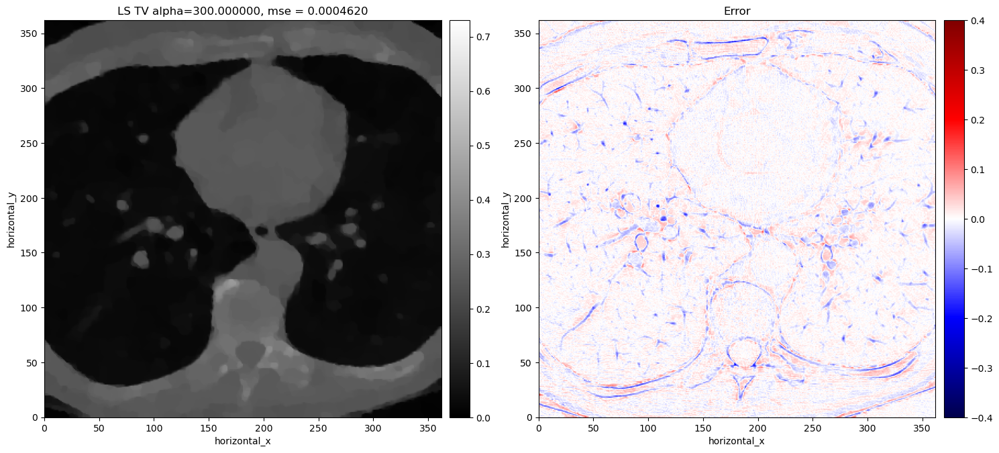

alpha=300.000000, mse= 0.0004620
0.0004650005756151232


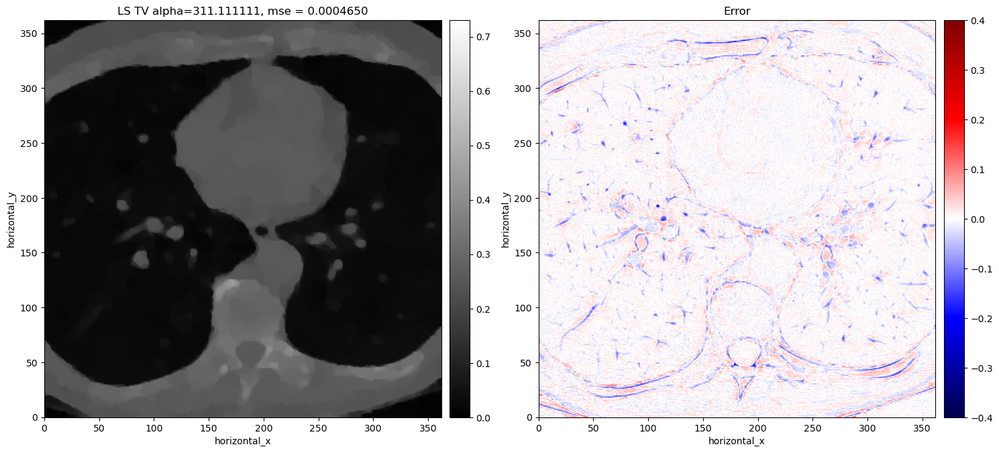

alpha=311.111111, mse= 0.0004650
0.00046806458293625674


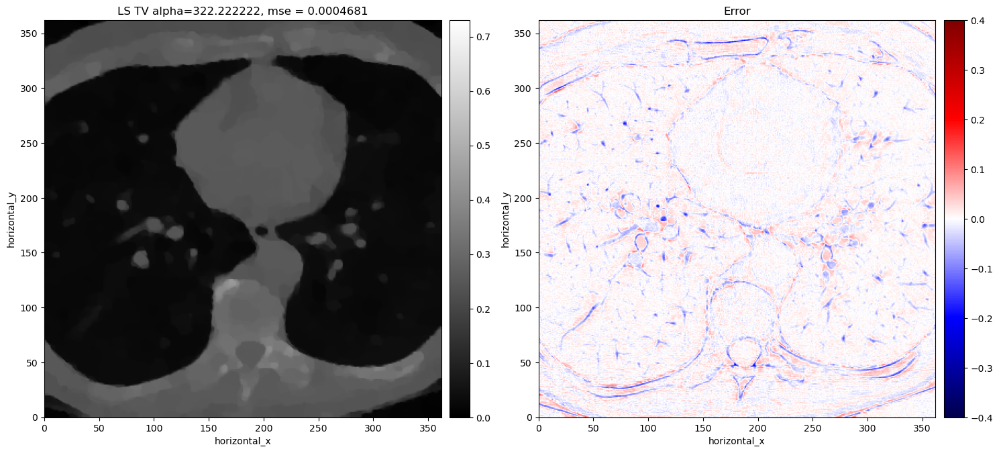

alpha=322.222222, mse= 0.0004681
0.0004711190421613071


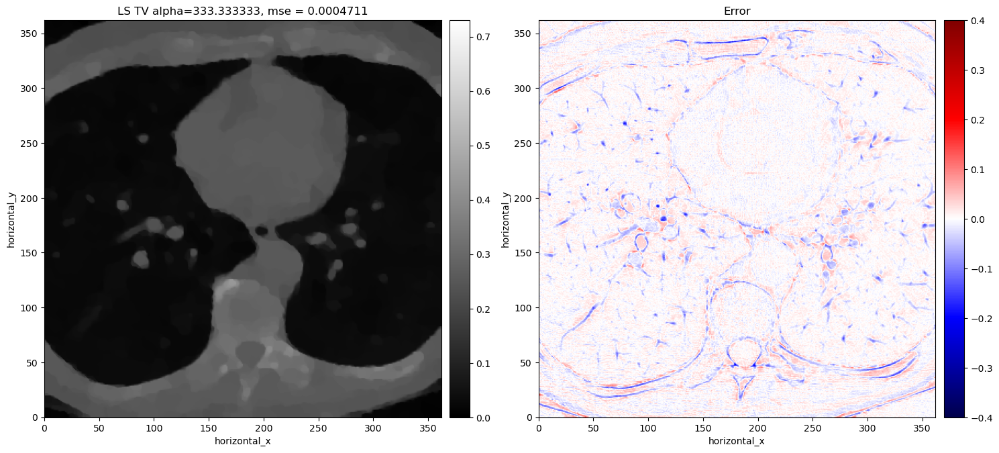

alpha=333.333333, mse= 0.0004711
0.00047416861089811976


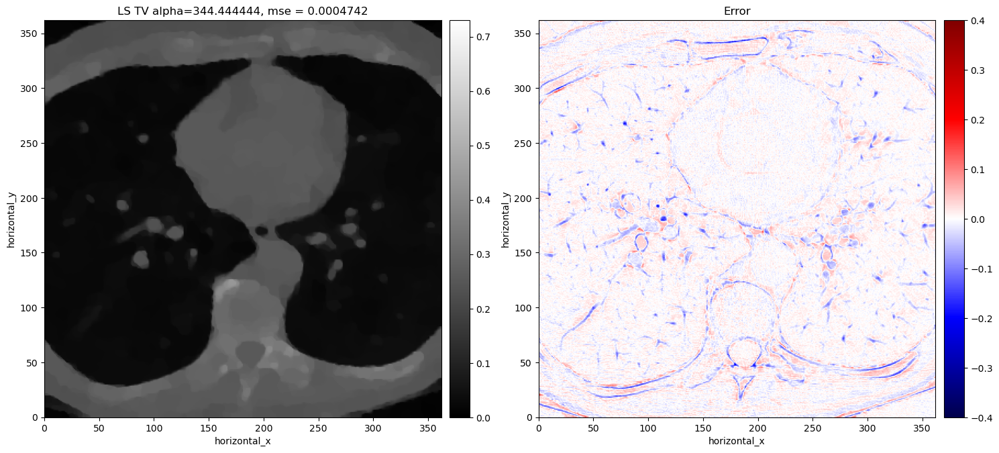

alpha=344.444444, mse= 0.0004742


In [80]:
#%% Reconstructing using least squares with TV regularisation 
# Selection of the best regularization parametr using LS TV - FISTA
alpha_min = 300
alpha_max = 400
alpha_n   = 10
alphas_ls    = np.linspace(alpha_min, alpha_max, alpha_n) 
modulo    = 1 #how often to plot the reconstructions, for the different values of alpha

#Definition of the fidelity term
f3 = LeastSquares(A, sinogram_noisy)

#Initialize quantities
mse_ls_tv_alpha = np.zeros_like(alphas_ls)
min_mse = 100

# Run the loop over the different values of alpha
for i in range(alpha_n):
    alpha = alphas_ls[i]
    # Defining the regularization term with the new alpha
    GTV_bound = alpha*TotalVariation(lower=0, upper=fdk.max())

    # Setting up FISTA
    myFISTATV = FISTA(f=f3, 
                  g=GTV_bound, 
                  max_iteration=1000, initial=ig.allocate(0), update_objective_interval=50)
    # Run FISTA
    myFISTATV.run(500, verbose=0)
    recon_ls_tv = myFISTATV.solution
    mse_ls_tv_alpha[i] = mse(gt,recon_ls_tv)
    print(mse_ls_tv_alpha[i])
    
 
    
    # Save the reconstruction (one every "modulo")
    if i%modulo == 0:
        show2D([recon_ls_tv, recon_ls_tv-gt], ["LS TV alpha=%7.6f, mse = %7.7f" % (alpha,mse_ls_tv_alpha[i]), 'Error'], cmap=[cmap, 'seismic'], fix_range=[(0, fdk.max()), (-0.4,0.4)])
        plt.savefig(f'./FISTA_TV/LS_TV alpha=%7.6f_mse_%7.7f_image.png' % (alpha,mse_ls_tv_alpha[i]))
        plt.close()

         # plot the objective function
        plt.figure(figsize=(5,5))
        plt.plot( myFISTATV.objective[5:],label="alpha =%7.6f" % (alpha))
        plt.legend(fontsize=10)
        plt.savefig(f'./FISTA_TV/LS_TV_alpha=%7.6f_mse_%7.7f_convergence.png' % (alpha,mse_ls_tv_alpha[i]), bbox_inches='tight',
    pad_inches = 0)
        plt.close()
    # print the value of alpha and the obtained mse of the reconstruction
    print("alpha=%7.6f, mse= %5.7f" % (alpha,mse_ls_tv_alpha[i]))
    
    # Save the best reconstruction
    if mse_ls_tv_alpha[i]<min_mse:
        min_mse   = mse_ls_tv_alpha[i]
        best_recon = recon_ls_tv
        best_alpha = alpha
        
#Save the best reconstructions 
recon_ls_tv_fista = best_recon
mse_ls_tv_fista  = min_mse
alpha_ls_tv_fista = best_alpha


# MSE for different values of alpha
plt.figure(figsize=(20,10))
plt.plot(alphas_ls,mse_ls_tv_alpha,label="LS TV")
plt.plot(alpha_ls_tv_fista, mse_ls_tv_fista, '*r')
plt.legend(fontsize=20)
plt.savefig('./FISTA_TV/LS_TV_alpha_mse.png')


### Wavelet regularisation

Using the wavelet in the accompanying python file, we can apply this to the ground truth image. We use Daubechies 2 wavelets (REFERENCE!!!) and consider a variety of different levels applied to the ground truth data. 

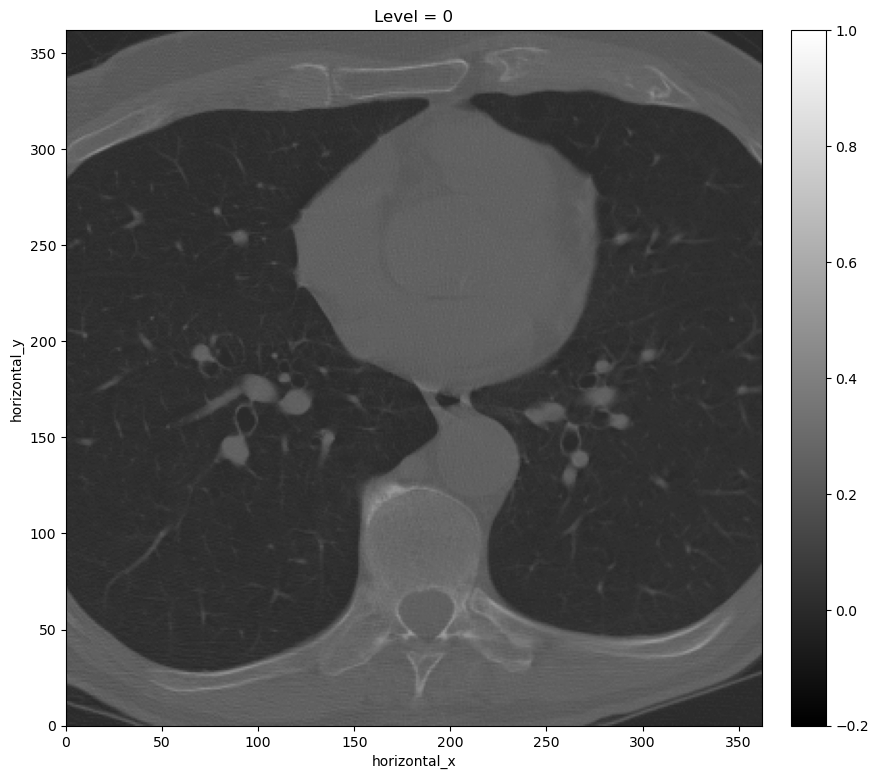

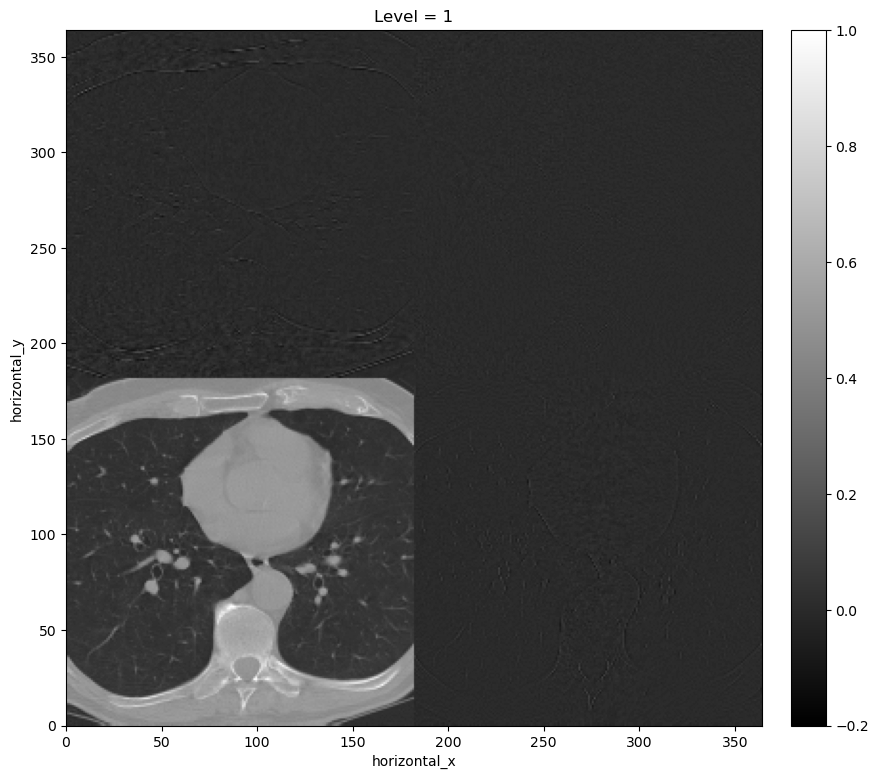

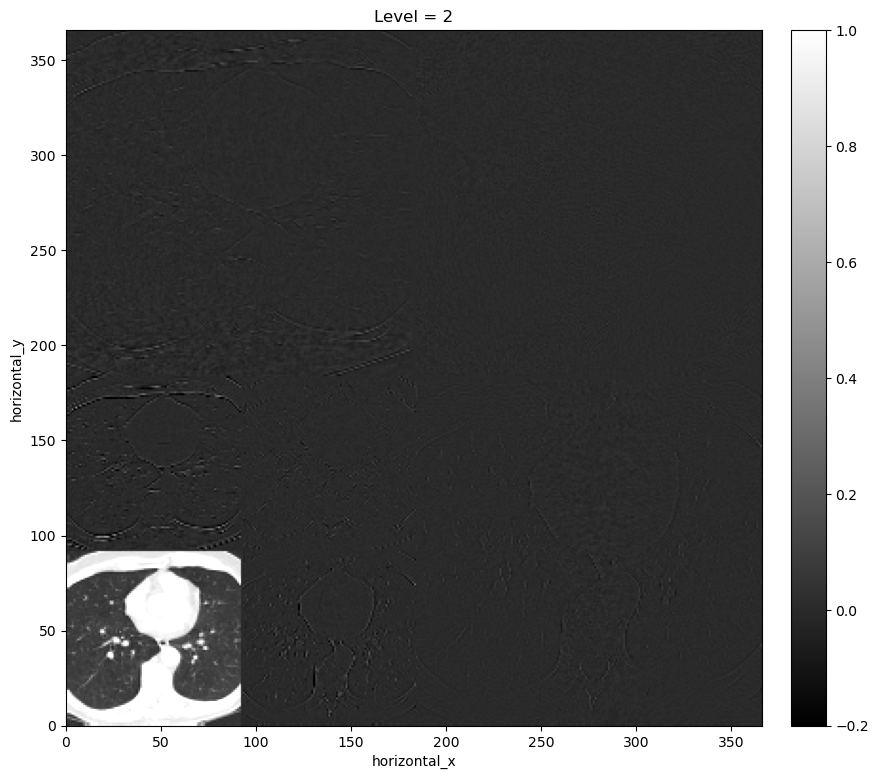

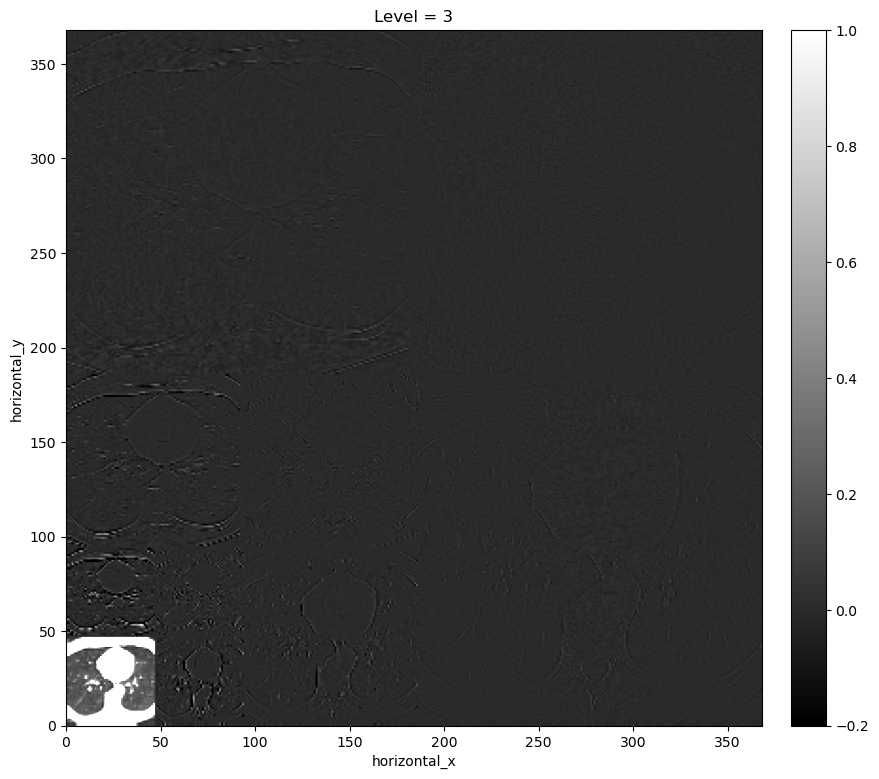

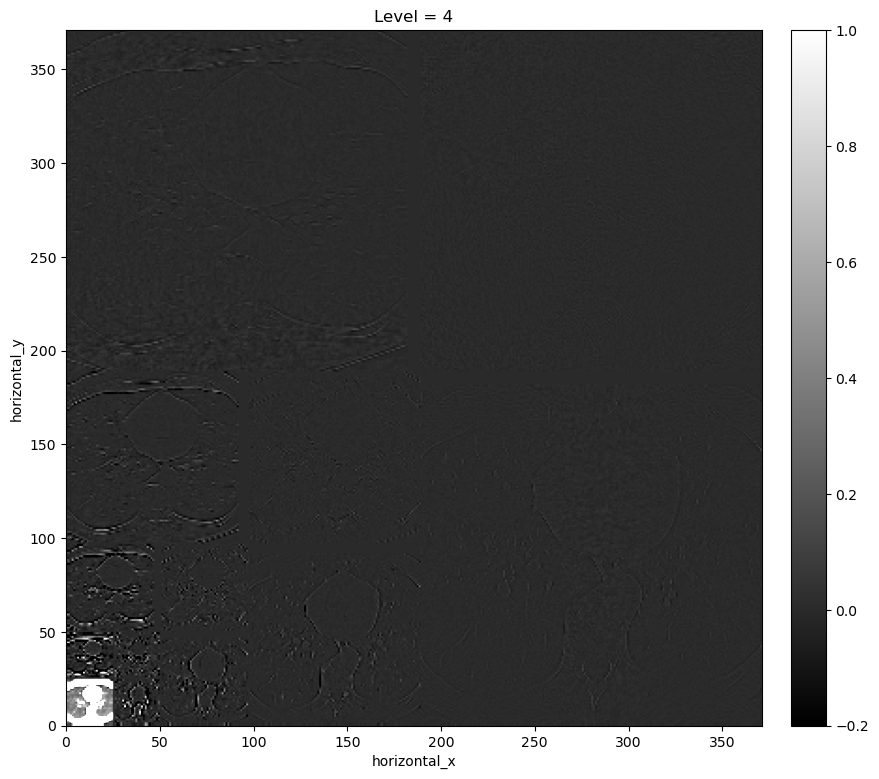

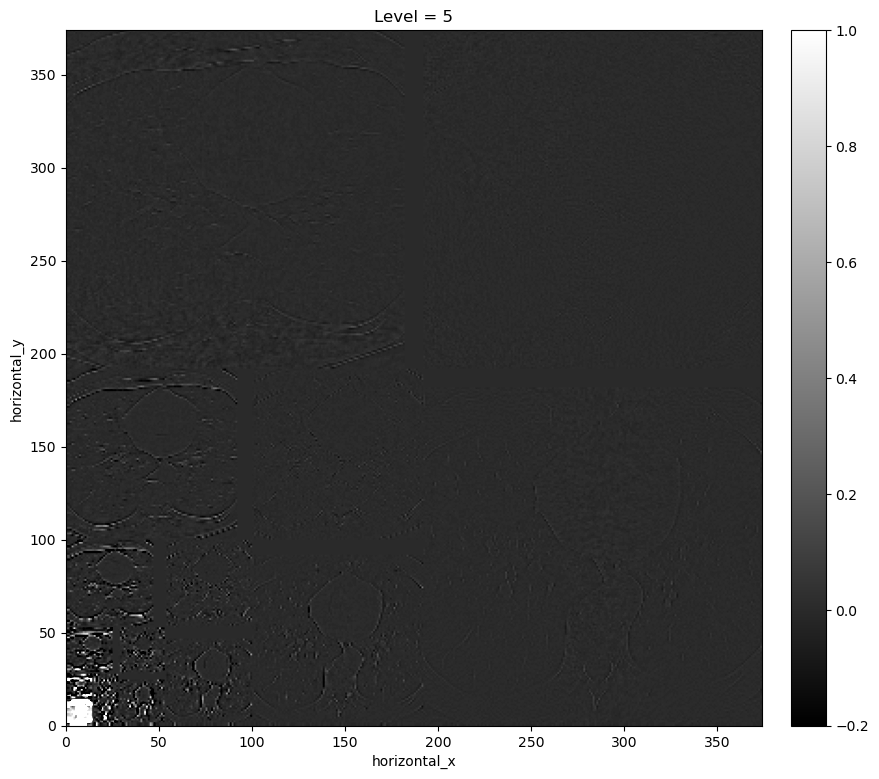

In [ ]:
wname = "db2"

for level in range(6):
    W = WaveletOperator(ig, level=level, wname=wname)

    show2D(W.direct(gt), 'Level = '+str(level), fix_range=(-.2,1))

We ask that the reconstructed image is spare (in the sense of the 1 -norm) under the Wavelet transform with level = 4. MATHS HERE. We try a range of regularisation parameters: 

/home/bih17925/miniconda3/envs/cil_23_1_0/lib/python3.10/site-packages/cil/optimisation/algorithms/PDHG.py:408: UserWarning: Convergence criterion of PDHG for scalar step-sizes is not satisfied.
  warnings.warn("Convergence criterion of PDHG for scalar step-sizes is not satisfied.")


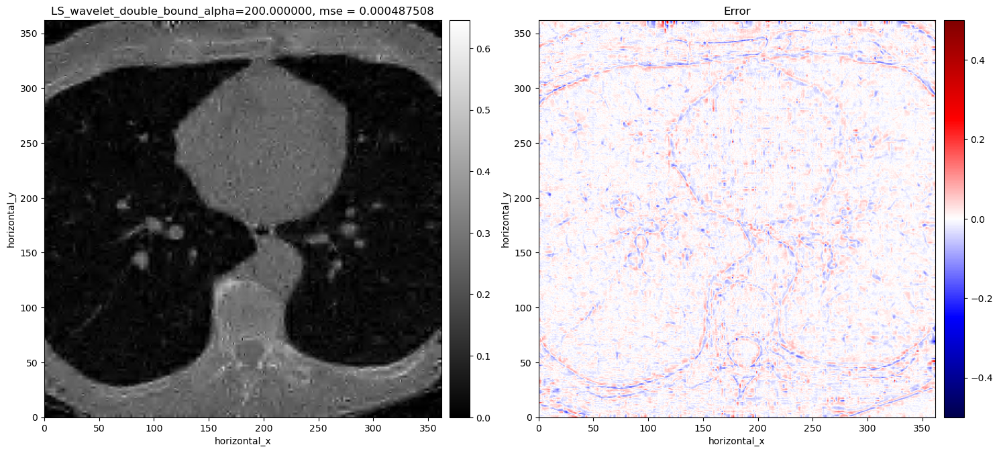

alpha=200.000000, mse= 0.001


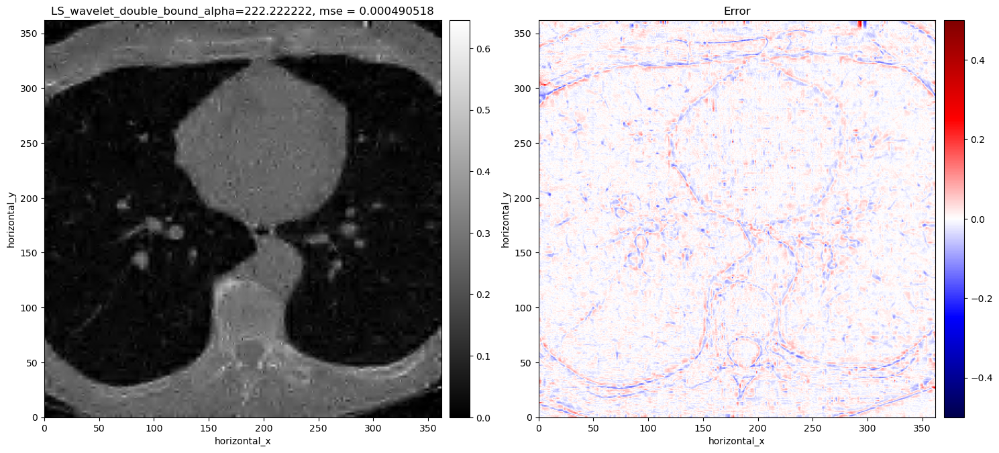

alpha=222.222222, mse= 0.001


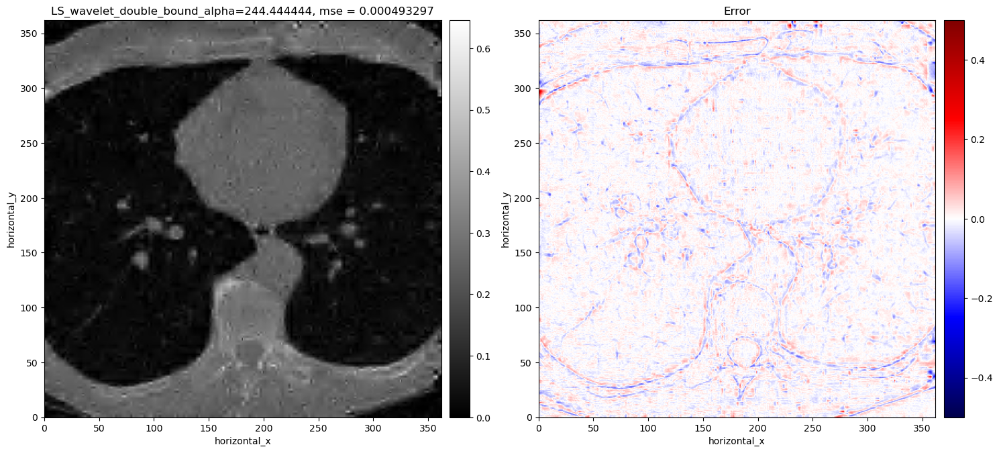

alpha=244.444444, mse= 0.001


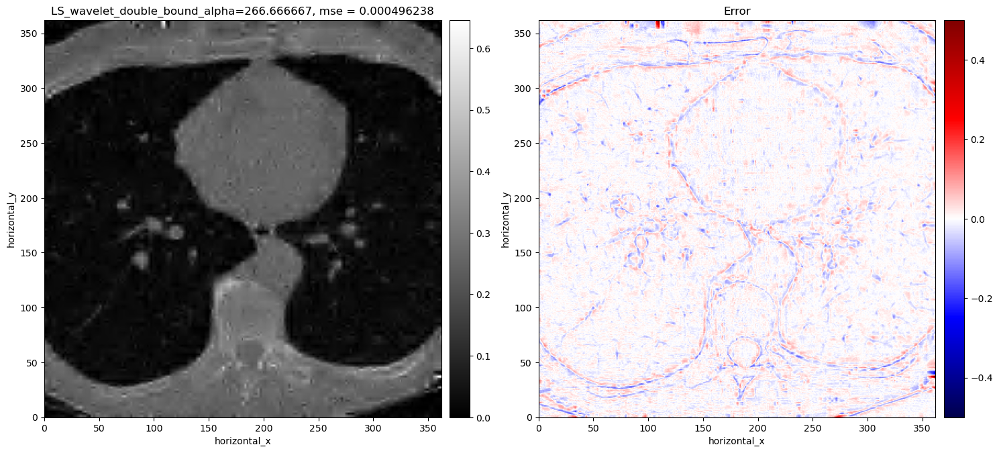

alpha=266.666667, mse= 0.001


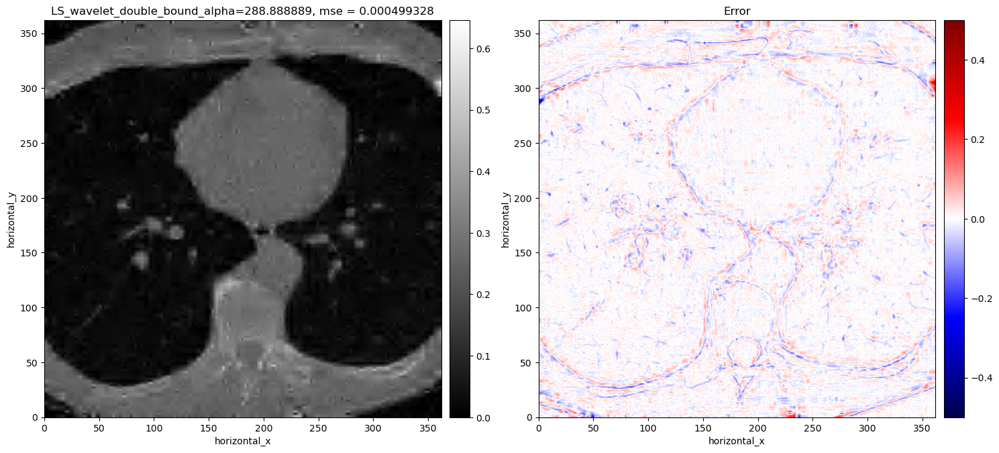

alpha=288.888889, mse= 0.001


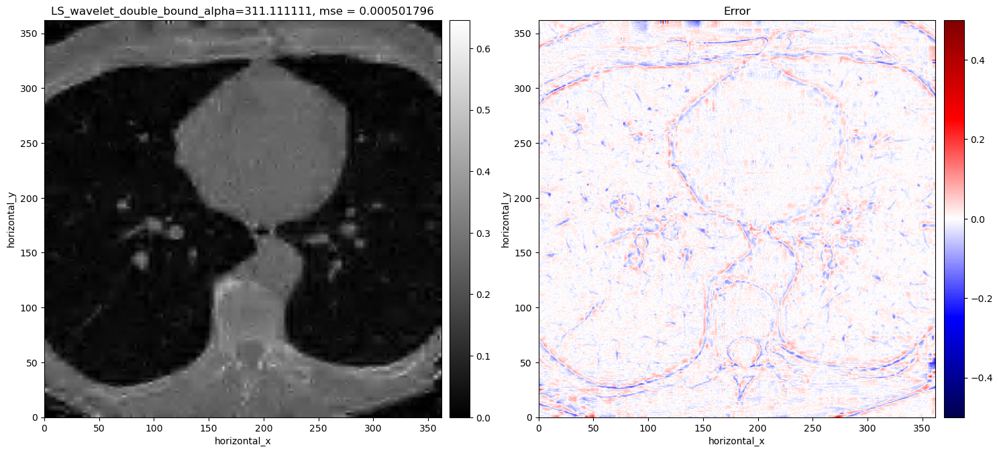

alpha=311.111111, mse= 0.001


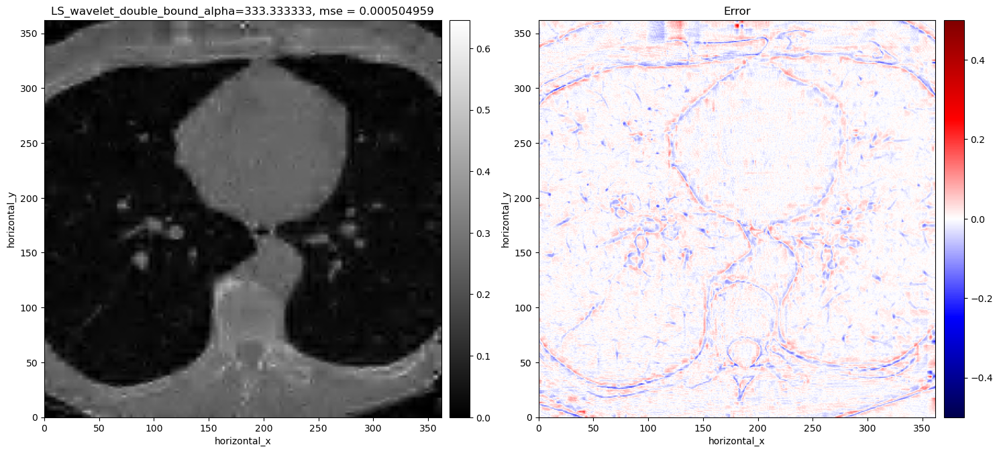

alpha=333.333333, mse= 0.001


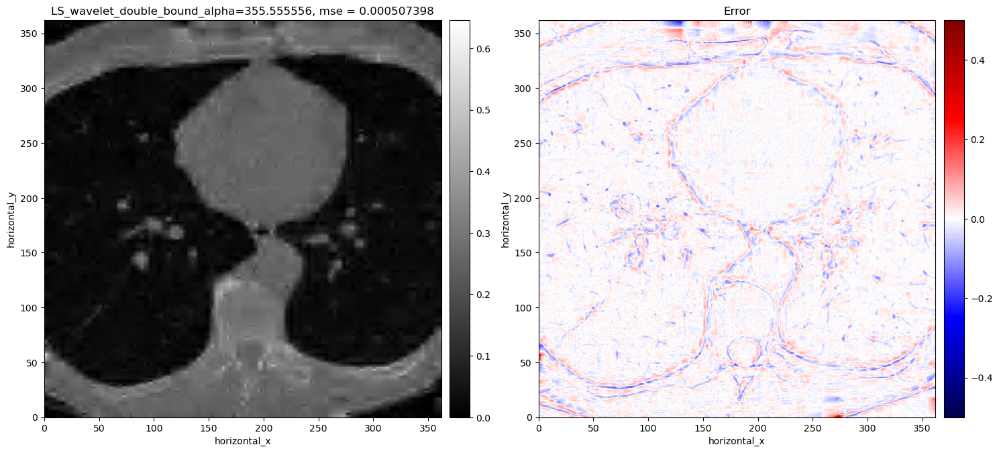

alpha=355.555556, mse= 0.001


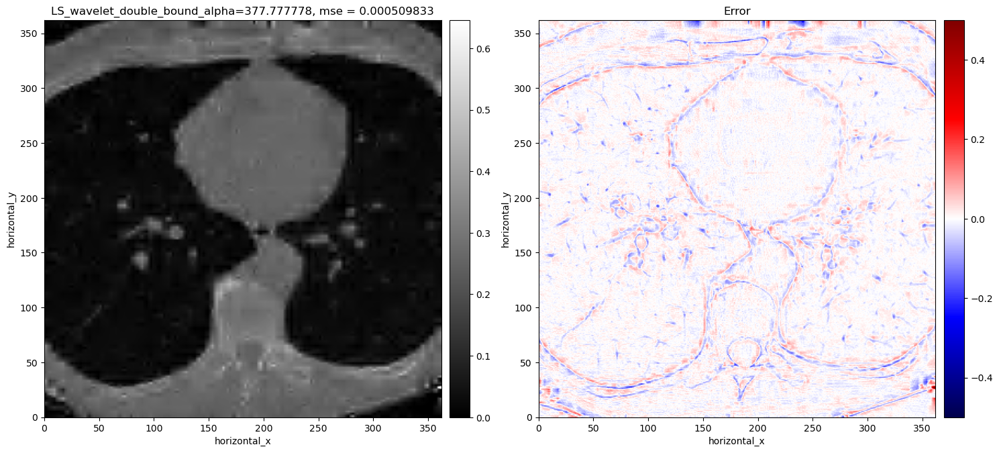

alpha=377.777778, mse= 0.001


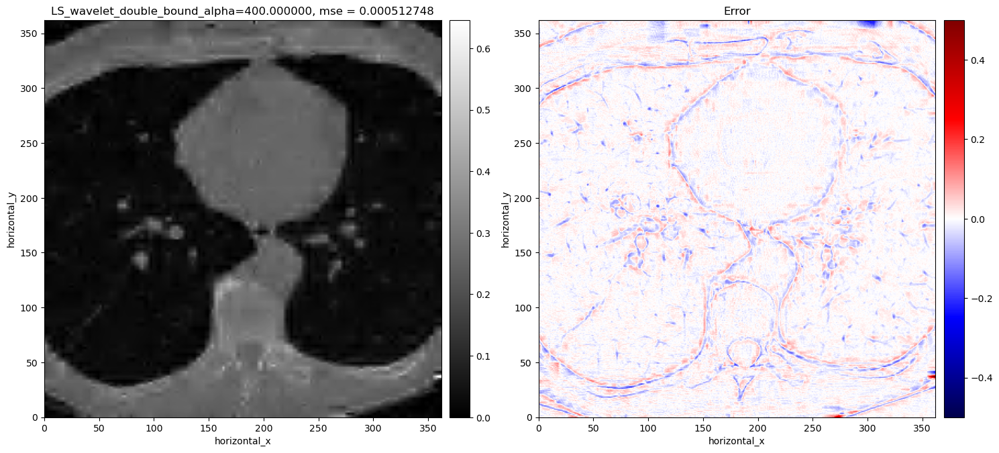

alpha=400.000000, mse= 0.001


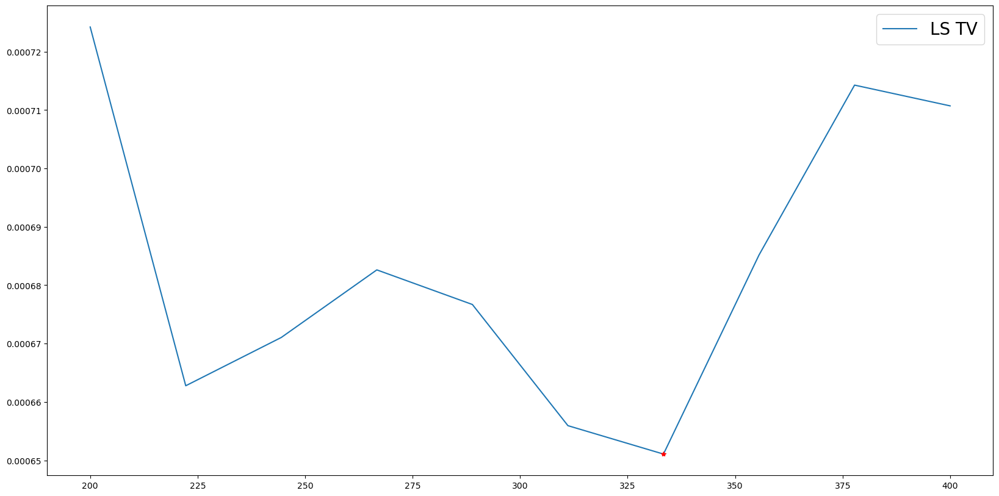

In [ ]:



alpha_min = 300
alpha_max = 350
alpha_n   = 10
alphas_ls    = np.linspace(alpha_min, alpha_max, alpha_n) 
modulo    = 1 #how often to plot the reconstructions, for the different values of alpha

level=4
W = WaveletOperator(ig, level=level, wname=wname)

#Initialwavelete quantities
mse_ls_wavelet_alpha = np.zeros_like(alphas_ls)
min_mse = 100

# Run the loop over the different values of alpha
for i in range(alpha_n):
    f1 = L2NormSquared(b=sinogram_noisy)

    
    f2 = L1Norm()
    F = BlockFunction(f1, f2)
    
    alpha = alphas_ls[i]
    K = BlockOperator(A, alpha*W)

    G = IndicatorBox(lower=ground_truth.min(), upper=ground_truth.max())
   
    # Setting up FISTA
    myPDHG_wavelet = PDHG(f=F, 
                  g=G, operator=K, 
                  max_iteration=2500, initial=ig.allocate('random'), update_objective_interval=50)
        # Run FISTA
    myPDHG_wavelet.run(2500, verbose=0)
    recon_ls_wavelet = myPDHG_wavelet.solution
    mse_ls_wavelet_alpha[i] = mse(gt,recon_ls_wavelet)
   
    
 
    
    # Save the reconstruction (one every "modulo")
    if i%modulo == 0:
        show2D([recon_ls_wavelet, recon_ls_wavelet-gt], ["LS_wavelet_double_bound_alpha=%7.6f, mse = %7.9f" % (alpha, mse_ls_tv_alpha[i]), 'Error'], cmap=[cmap, 'seismic'], fix_range=[(0,fdk.max()), (-0.5, 0.5) ])
        plt.savefig(f'./PDHG_wavelet/LS_Tv_double_bound alpha=%7.6f_mse_%7.5f_error.png' % (alpha,mse_ls_wavelet_alpha[i]))
        plt.close()
         # plot the objective function
        plt.figure(figsize=(5,5))
        plt.plot( myPDHG_wavelet.objective[5:],label="alpha =%7.6f" % (alpha))
        plt.legend(fontsize=10)
        plt.savefig(f'./PDHG_wavelet/LSwaveletV_alpha=%7.6f_mse_%7.5f_convergence.png' % (alpha,mse_ls_tv_alpha[i]), bbox_inches='tight',
    pad_inches = 0)
        plt.close()
    # print the value of alpha and the obtained mse of the reconstruction
    print("alpha=%7.6f, mse= %5.3f" % (alpha,mse_ls_wavelet_alpha[i]))
    
    # Save the best reconstruction
    if mse_ls_wavelet_alpha[i]<min_mse:
        min_mse   = mse_ls_wavelet_alpha[i]
        best_recon = recon_ls_wavelet
        best_alpha = alpha
        
#Save the best reconstructions 
recon_ls_tv_fista = best_recon
mse_ls_wavelet_fista  = min_mse
alpha_ls_wavelet_fista = best_alpha


# MSE for different values of alpha
plt.figure(figsize=(20,10))
plt.plot(alphas_ls,mse_ls_wavelet_alpha,label="LS TV")
plt.plot(alpha_ls_wavelet_fista, mse_ls_wavelet_fista, '*r')
plt.legend(fontsize=20)
plt.savefig('./PDHG_wavelet/LS_TV_alpha_mse.png')


In [ ]:
### Wavelet and TV regularisation 

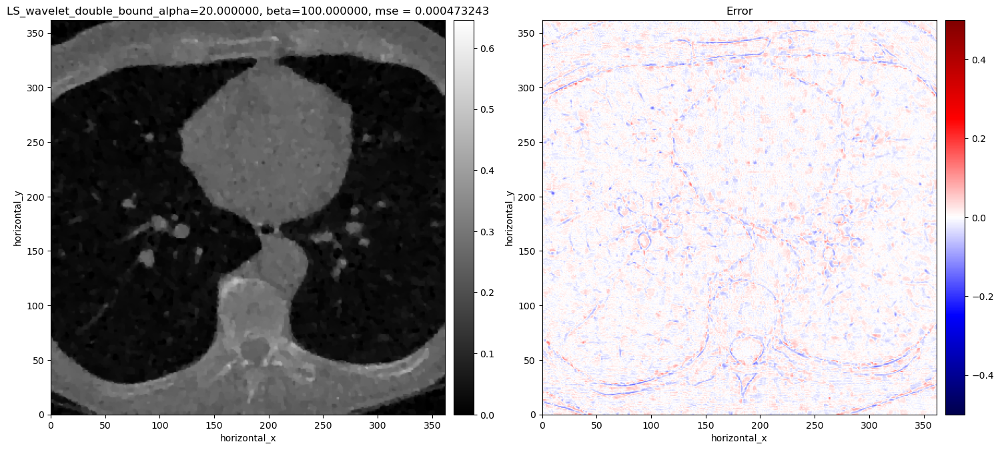

alpha=20.000000, beta_100.000000, mse= 0.000473


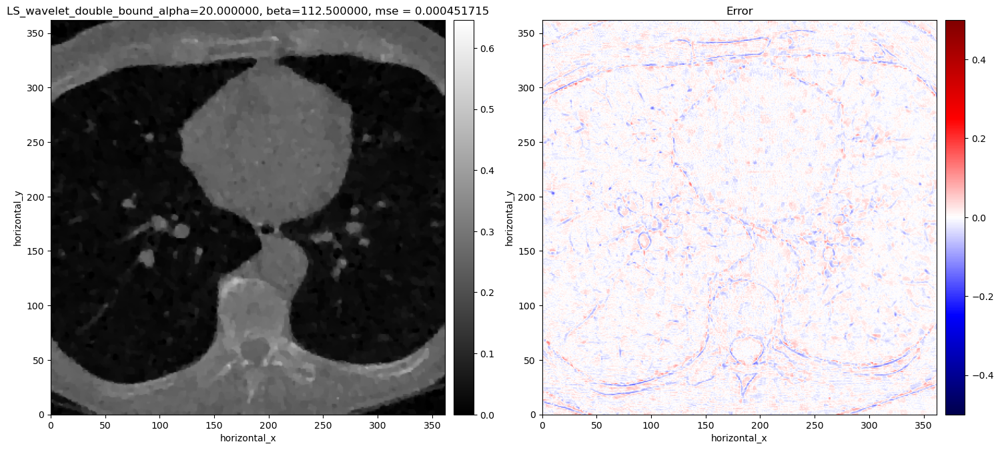

alpha=20.000000, beta_112.500000, mse= 0.000452


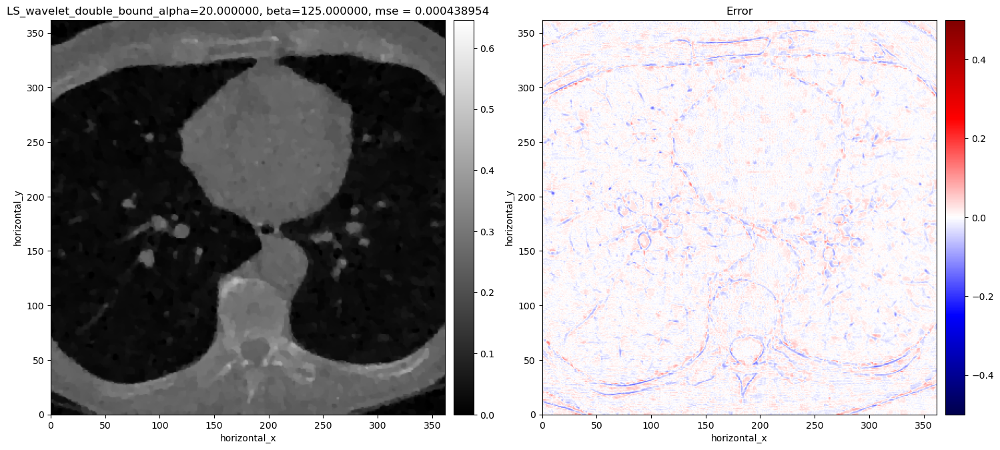

alpha=20.000000, beta_125.000000, mse= 0.000439


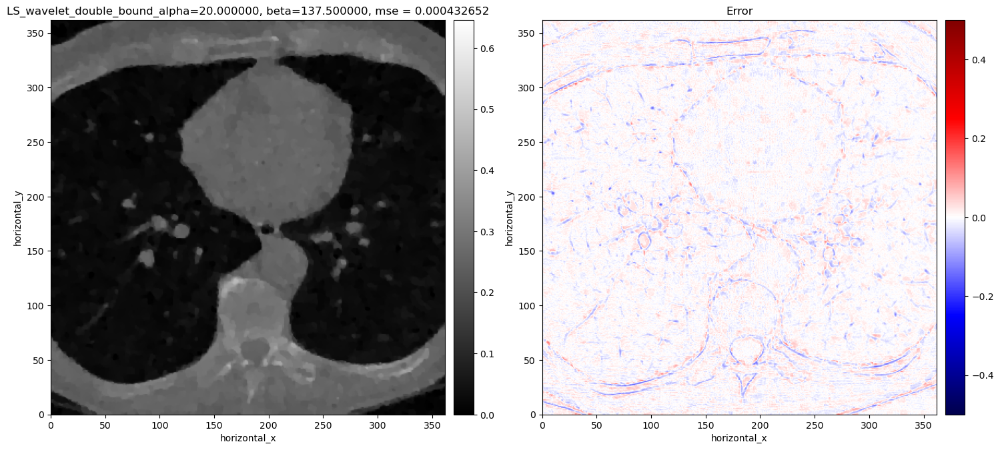

alpha=20.000000, beta_137.500000, mse= 0.000433


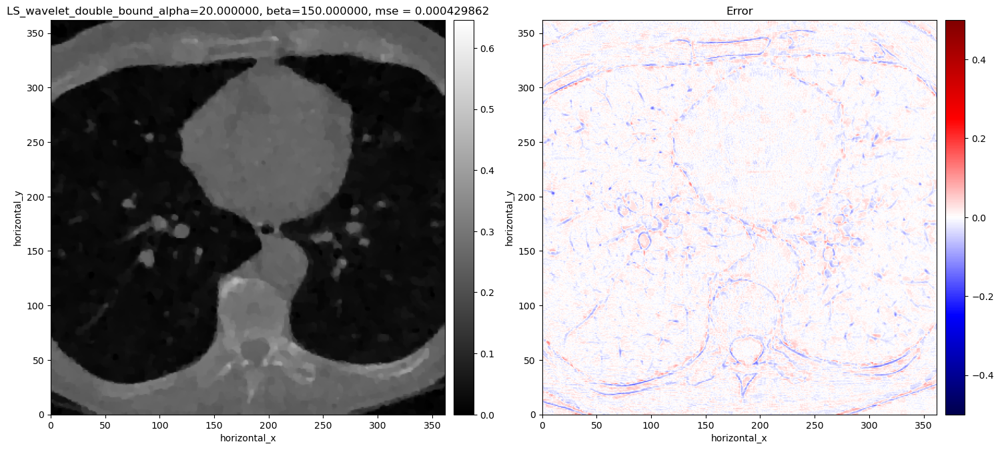

alpha=20.000000, beta_150.000000, mse= 0.000430


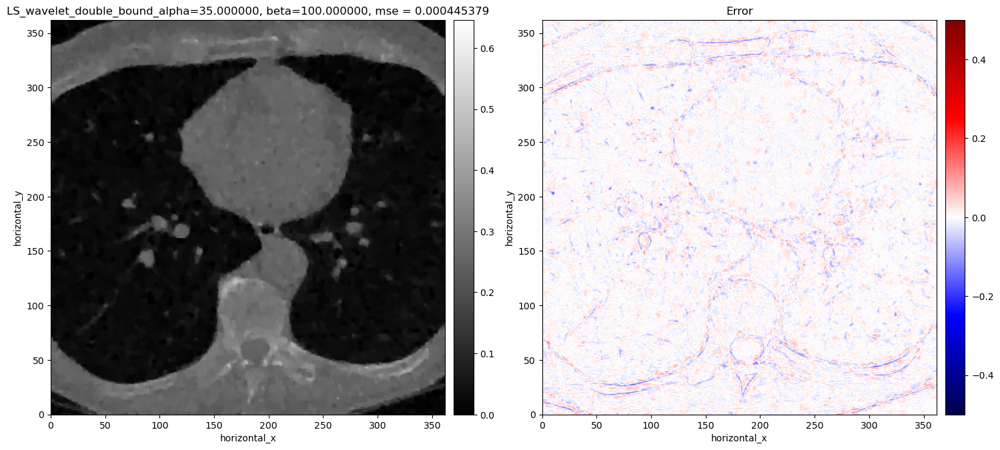

alpha=35.000000, beta_100.000000, mse= 0.000445


/home/bih17925/miniconda3/envs/cil_23_1_0/lib/python3.10/site-packages/cil/optimisation/algorithms/PDHG.py:408: UserWarning: Convergence criterion of PDHG for scalar step-sizes is not satisfied.
  warnings.warn("Convergence criterion of PDHG for scalar step-sizes is not satisfied.")


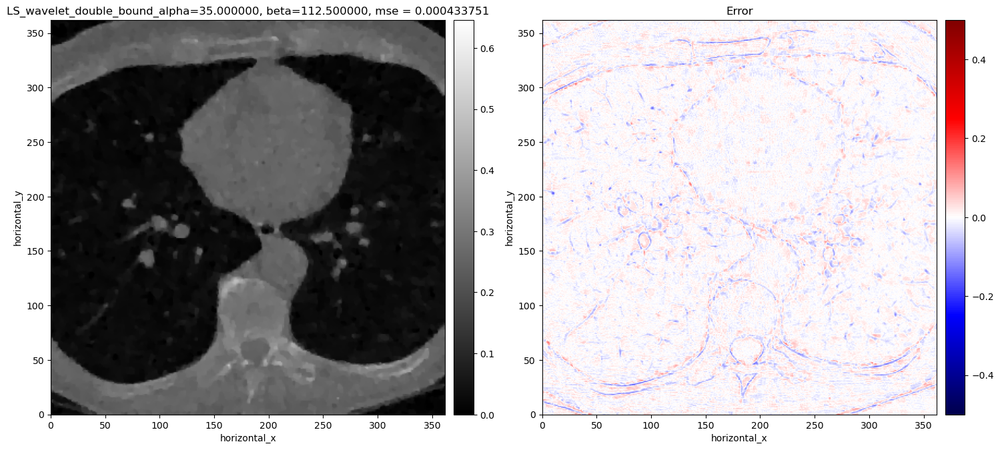

alpha=35.000000, beta_112.500000, mse= 0.000434


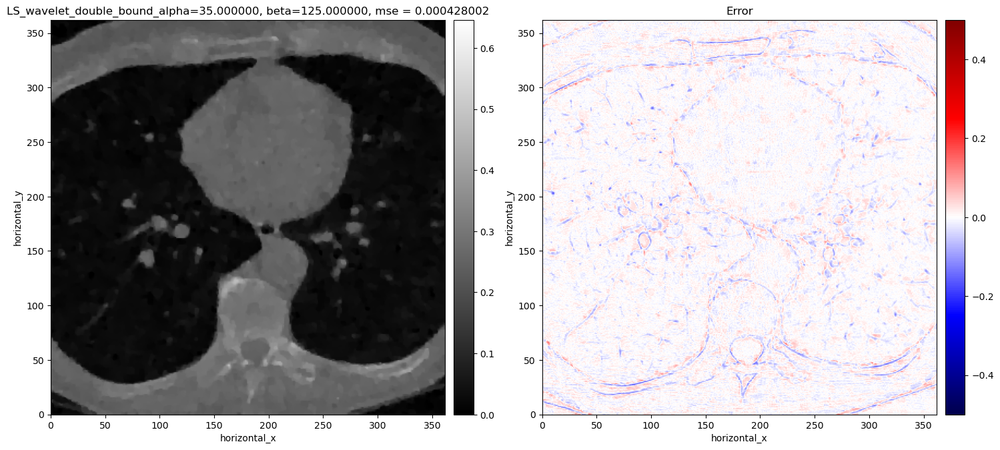

alpha=35.000000, beta_125.000000, mse= 0.000428


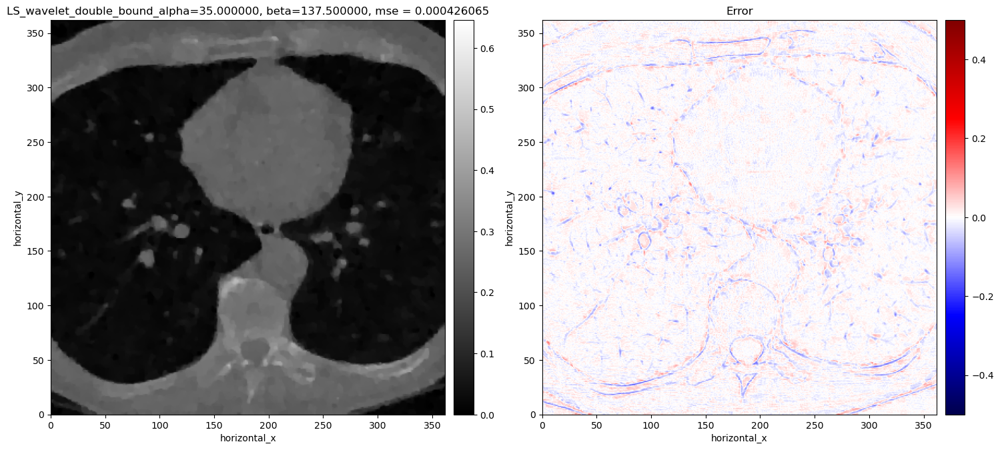

alpha=35.000000, beta_137.500000, mse= 0.000426


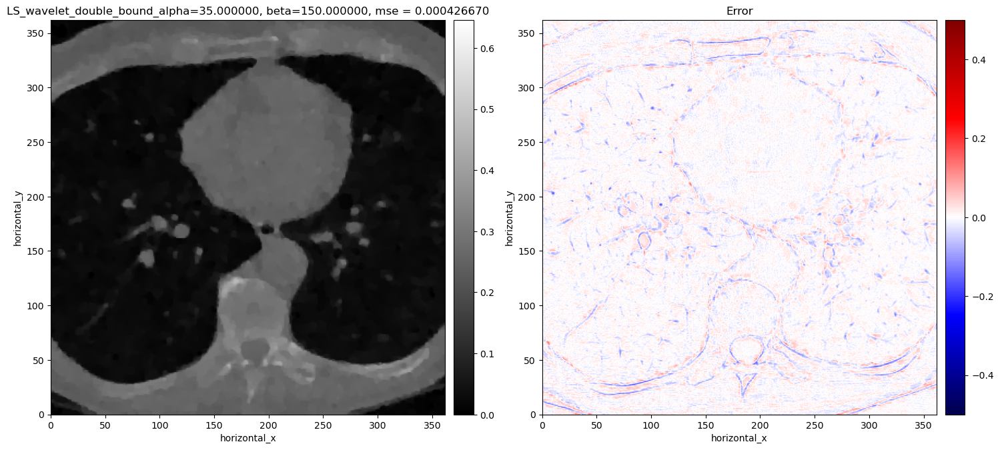

alpha=35.000000, beta_150.000000, mse= 0.000427


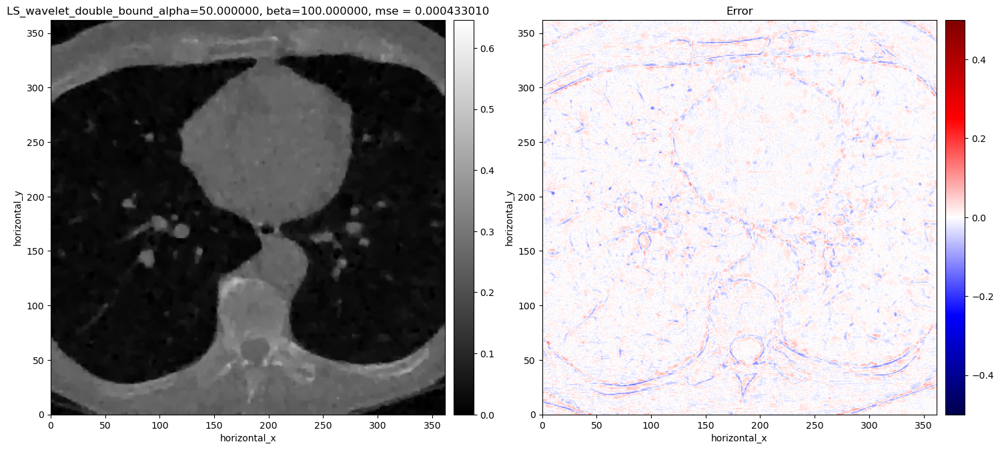

alpha=50.000000, beta_100.000000, mse= 0.000433


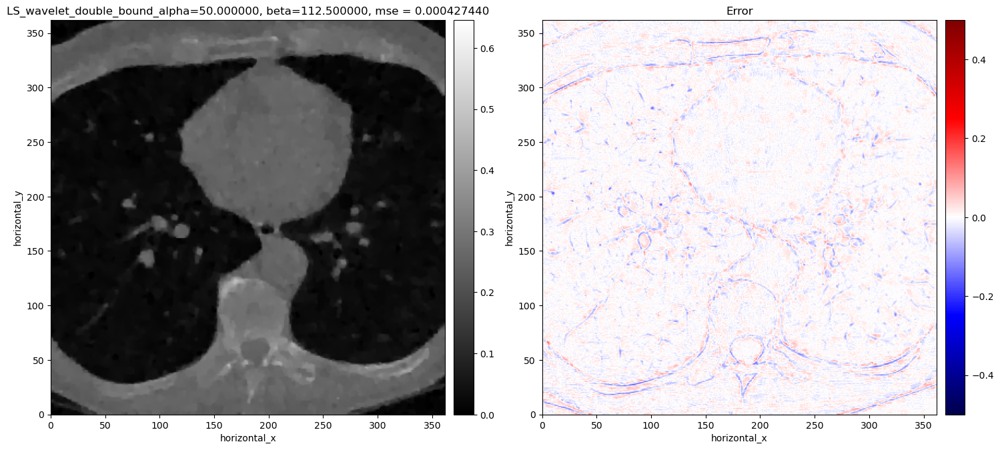

alpha=50.000000, beta_112.500000, mse= 0.000427


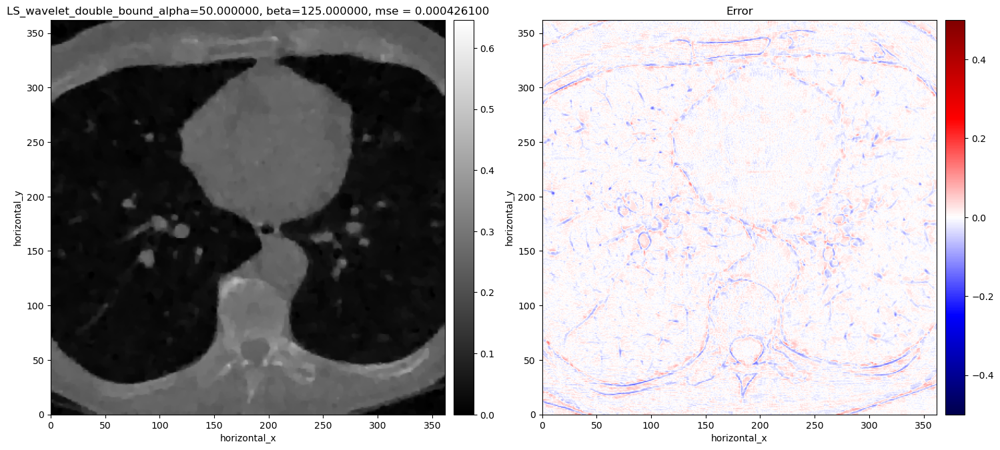

alpha=50.000000, beta_125.000000, mse= 0.000426


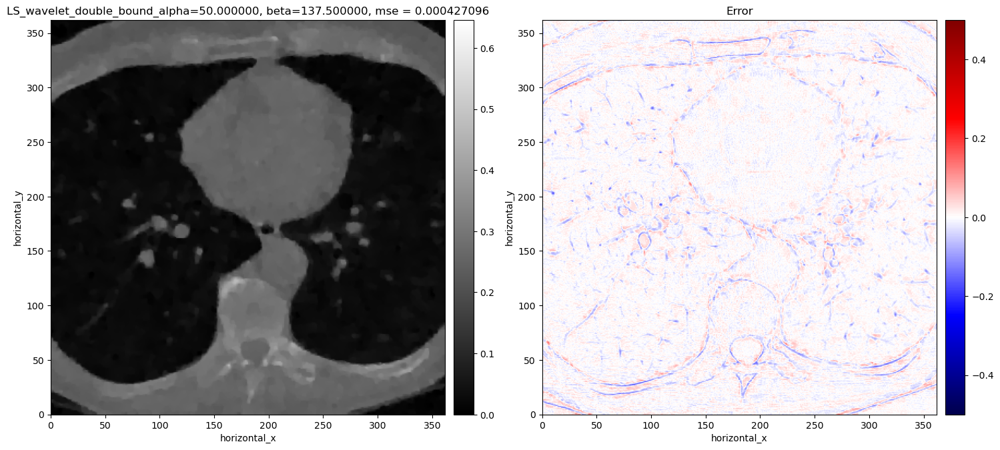

alpha=50.000000, beta_137.500000, mse= 0.000427


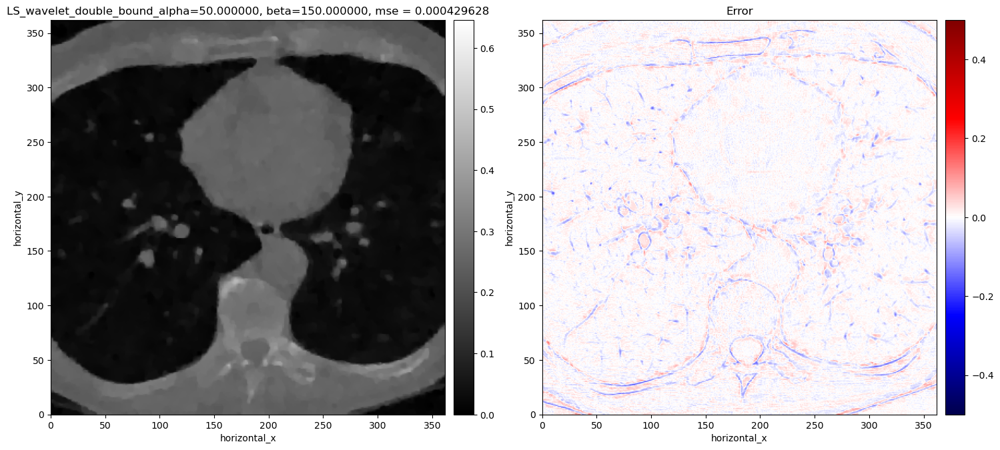

alpha=50.000000, beta_150.000000, mse= 0.000430


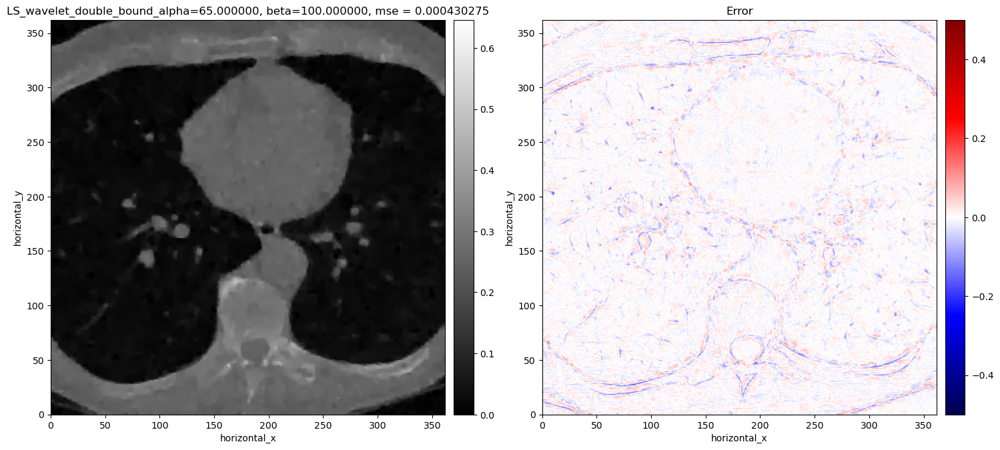

alpha=65.000000, beta_100.000000, mse= 0.000430


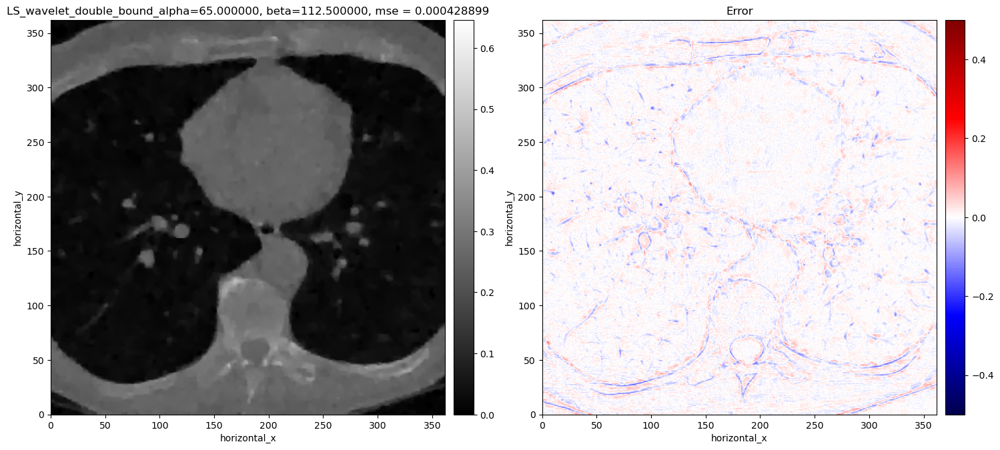

alpha=65.000000, beta_112.500000, mse= 0.000429


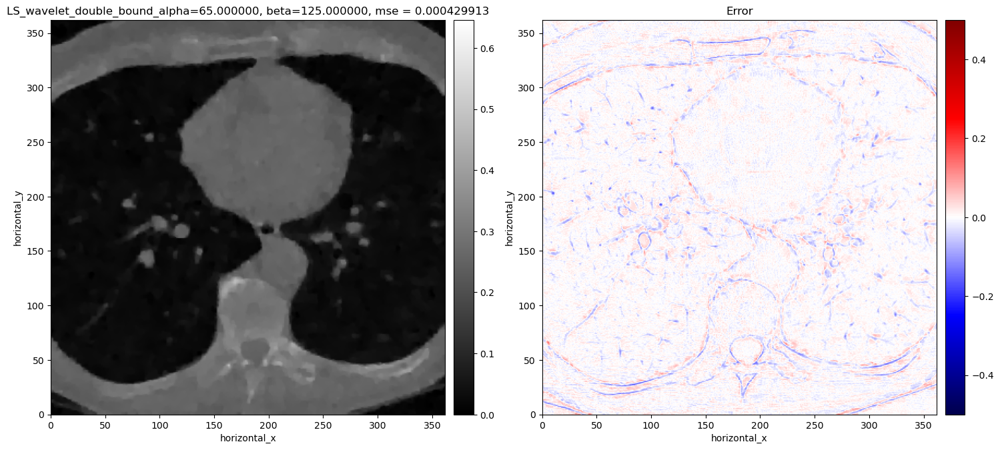

alpha=65.000000, beta_125.000000, mse= 0.000430


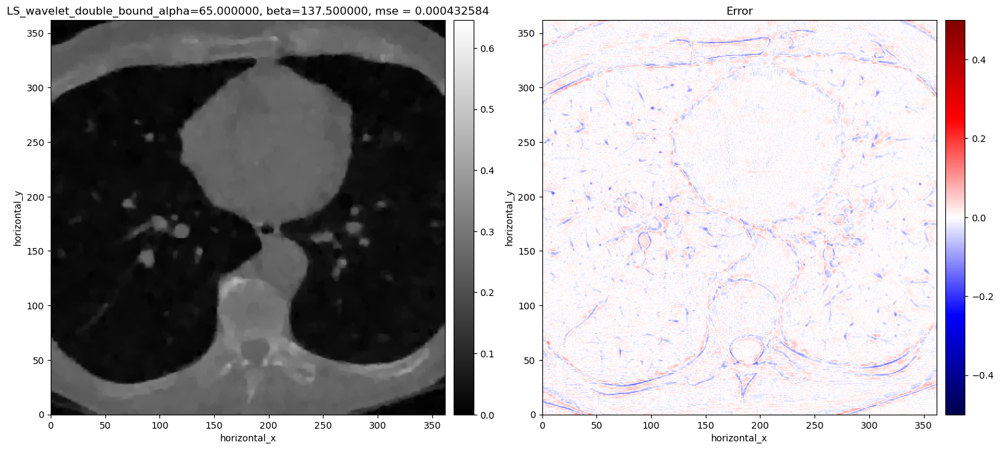

alpha=65.000000, beta_137.500000, mse= 0.000433


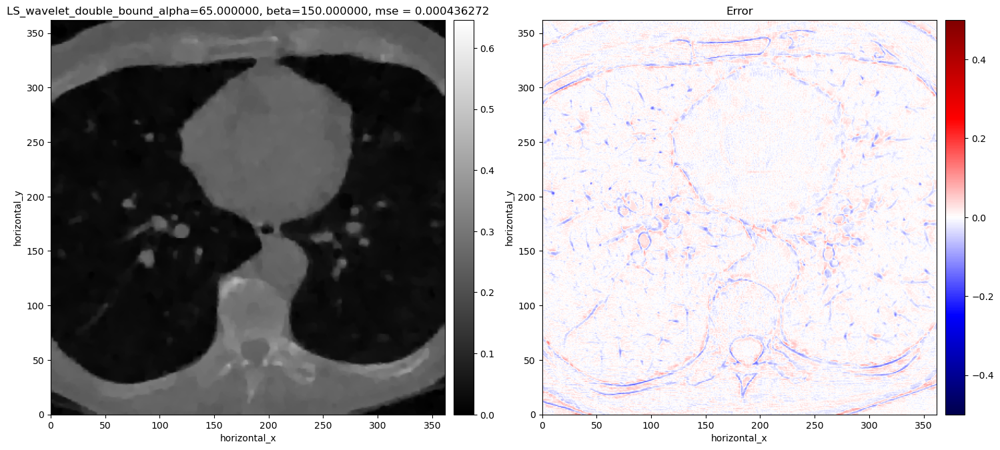

alpha=65.000000, beta_150.000000, mse= 0.000436


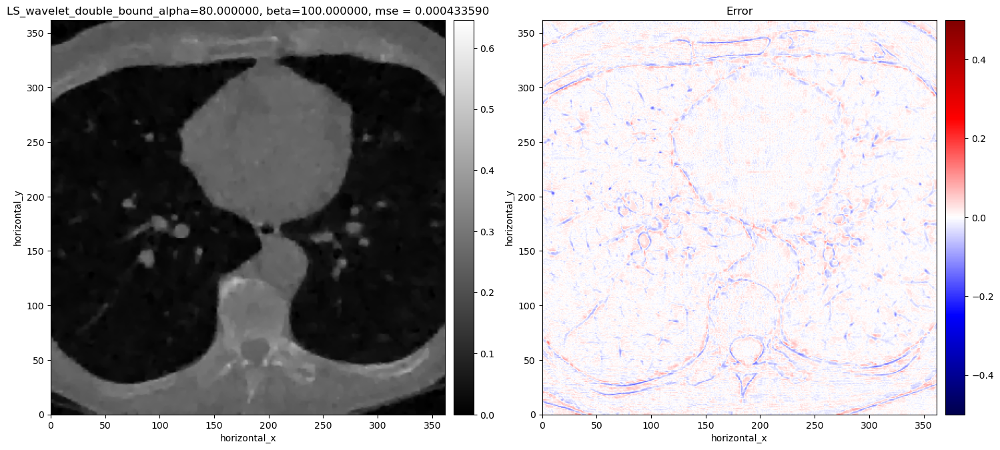

alpha=80.000000, beta_100.000000, mse= 0.000434


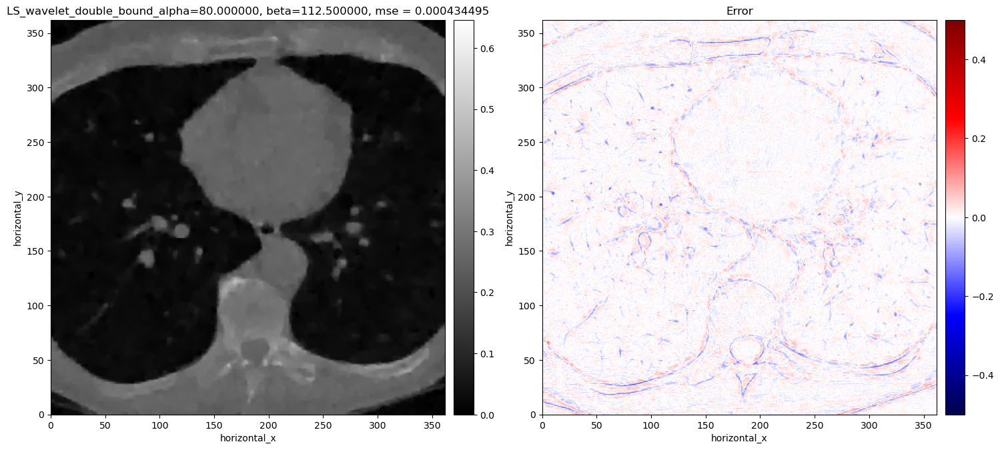

alpha=80.000000, beta_112.500000, mse= 0.000434


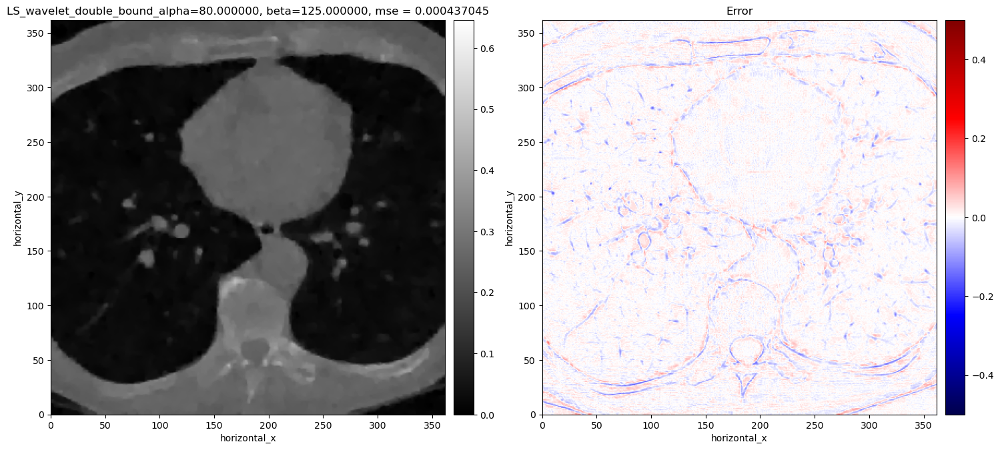

alpha=80.000000, beta_125.000000, mse= 0.000437


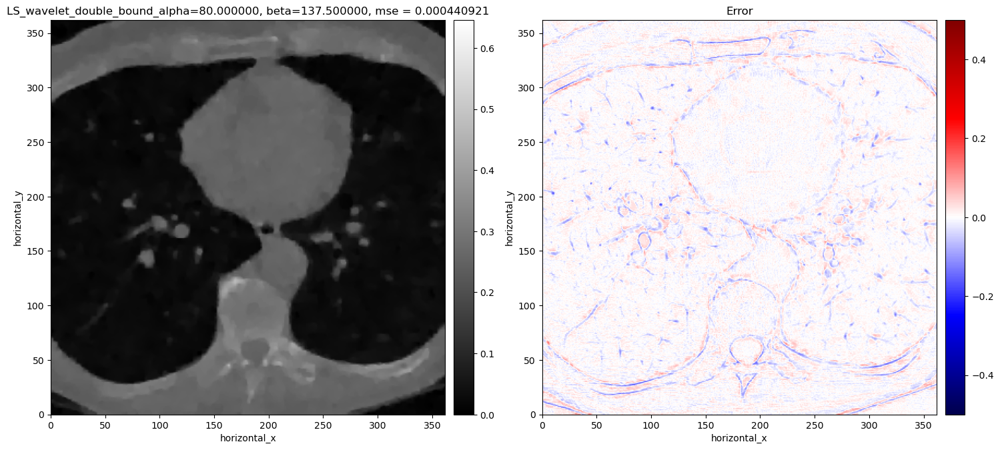

alpha=80.000000, beta_137.500000, mse= 0.000441


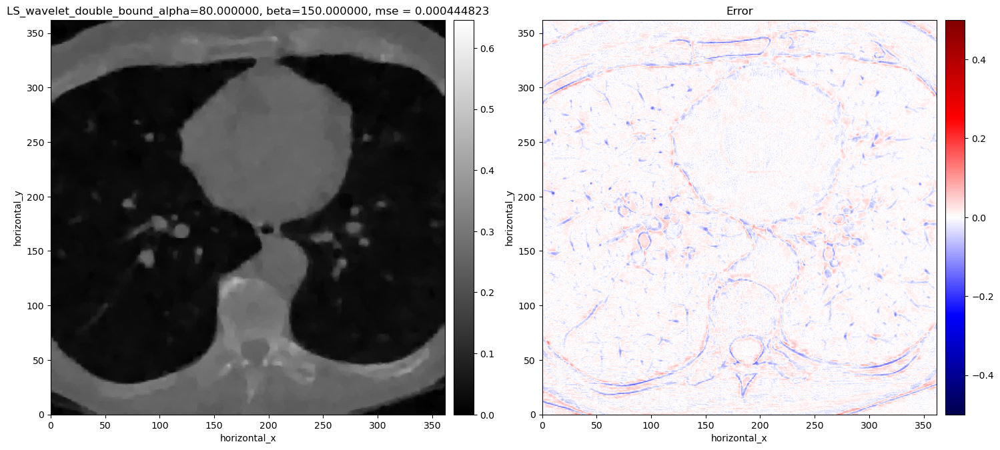

alpha=80.000000, beta_150.000000, mse= 0.000445


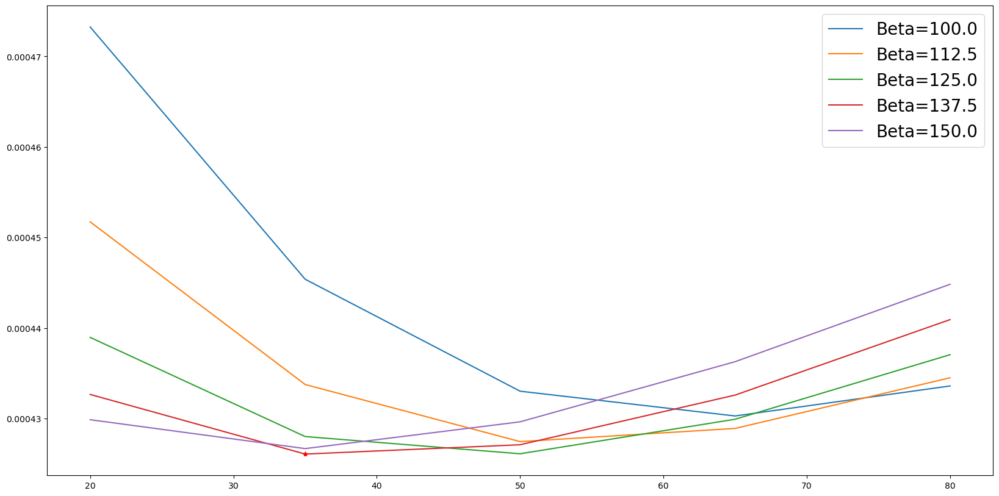

In [ ]:
alpha_min = 30
alpha_max = 50
alpha_n   = 5
beta_min=130
beta_max=140
beta_n=5
alphas_ls    = np.linspace(alpha_min, alpha_max, alpha_n) 
betas_ls    = np.linspace(beta_min, beta_max, beta_n) 
modulo    = 1 #how often to plot the reconstructions, for the different values of alpha


#Initialize quantities
mse_ls_wavelet_tv_alpha_beta = np.zeros((alpha_n, beta_n))
min_mse = 100

A = ProjectionOperator(ig, AG)

for i in range(alpha_n):
    for j in range(beta_n):
        wname = "db2"
        level = 4
        W = WaveletOperator(ig, level=level, wname=wname)
        f1 = L2NormSquared(b=sinogram_noisy)
        alpha = alphas_ls[i]
        beta = betas_ls[j]
        Grad = GradientOperator(ig)
        f3 = MixedL21Norm()
        K = BlockOperator(A, alpha * W, beta*Grad)
        f2 = L1Norm()
        F = BlockFunction(f1, f2, f3)
    
        G = IndicatorBox(lower=ground_truth_slice.min(), upper=ground_truth_slice.max())
    
        # Setting up PDHG
        myPDHGTV = PDHG(f=F, 
                    g=G, operator=K, 
                    max_iteration=2500, initial=ig.allocate('random'), update_objective_interval=50)
        # Run PDHG
        myPDHGTV.run(2000, verbose=0)
        recon_ls_wavelet_tv = myPDHGTV.solution
        mse_ls_wavelet_tv_alpha_beta[i,j] = mse(gt,recon_ls_wavelet_tv)
              
    
        
        # Save the reconstruction (one every "modulo")
        if i%modulo == 0:
            show2D([recon_ls_wavelet_tv, recon_ls_wavelet_tv-gt], ["LS_wavelet_double_bound_alpha=%7.6f, beta=%7.6f, mse = %7.9f" % (alpha,beta, mse_ls_wavelet_tv_alpha_beta[i,j]), 'Error'], cmap=[cmap, 'seismic'], fix_range=[(0,fdk.max()), (-0.5, 0.5) ])
            plt.savefig(f'./PDHG_wavelet_tv/LS_wavelet_tv_alpha=%7.6f_beta_%7.6f_mse_%7.5f_image.png' % (alpha,beta, mse_ls_wavelet_tv_alpha_beta[i,j]))
            plt.close()
            # plot the objective function
            plt.figure(figsize=(5,5))
            plt.plot( myPDHGTV.objective[5:],label="alpha =%7.6f" % (alpha))
            plt.legend(fontsize=10)
            plt.savefig(f'./PDHG_wavelet_tv/LS_wavelet_tv_alpha=%7.6f_beta_%7.6f_mse_%7.5f_convergence.png' % (alpha,beta, mse_ls_wavelet_tv_alpha_beta[i,j]), bbox_inches='tight')
            plt.close()
        # print the value of alpha and the obtained mse of the reconstruction
        print("alpha=%7.6f, beta_%7.6f, mse= %5.6f" % (alpha,beta, mse_ls_wavelet_tv_alpha_beta[i,j]))
        
        # Save the best reconstruction
        if mse_ls_wavelet_tv_alpha_beta[i,j]<min_mse:
            min_mse   = mse_ls_wavelet_tv_alpha_beta[i,j]
            best_recon = recon_ls_wavelet_tv
            best_alpha = alpha
            best_beta=beta
    
#Save the best reconstructions 
recon_ls_wavelet_tv_PDHG = best_recon
mse_ls_wavelet_tv_PDHG = min_mse
alpha_ls_wavelet_tv_PDHG = best_alpha
beta_ls_wavelet_tv_PDHG = best_beta

# MSE for different values of alpha
plt.figure(figsize=(20,10))
for j in range(beta_n):
    plt.plot(alphas_ls,mse_ls_wavelet_tv_alpha_beta[:,j],label="Beta={}".format(betas_ls[j]))
plt.plot(alpha_ls_wavelet_tv_PDHG, mse_ls_wavelet_tv_PDHG, '*r')
plt.legend(fontsize=20)
plt.savefig('./PDHG_wavelet_tv/LS_wavelet_tv_alpha_beta_mse.png')



In [ ]:
### Reconstruction comparisons 